# Base layers

Among the many layers of data available, some have actually high granularity and will be used as a renormalising function to distribute values that would otherwise be uniform in space.
The idea is to link certain economic activity related variables to some infrastructure and geographic layers, and assuming some form of homogeneity, distribute the economic activity 
proposrtionally to the the distribution, say, of infrastrucutre in a location. This notebook will lay some basis for this. 

In [1]:
#Base
import itertools as iter
import os
import re
import math
import numpy as np
import random as rd
import glob
import dask

# data eng
import h3
import shapely as shp
import geopandas as gpd
import pandas as pd
import rioxarray as rx
import osmnx as ox
import pyarrow
import ibis as ib
from ibis import _
ib.options.interactive = True
import ibis.selectors as s
# import polars as pl

# module
import scale_nav as sd
import data as dt
from plotting import cmap

### Visualisation related
from IPython.display import display
import ipywidgets
import contextily as cx
import pydeck as pdk
from matplotlib import pyplot as plt
import seaborn as sns
import pypalettes as pypal

### Relevant docs

ddb spatial extension web: https://duckdb.org/docs/extensions/spatial.html

ddb spatial extension github functions ref: https://github.com/duckdb/duckdb_spatial/blob/main/docs/functions.md

H3 + duckdb extension : https://github.com/isaacbrodsky/h3-duckdb 

ibis + geospatial : 

general : https://ibis-project.org/reference/expression-tables#attributes 

blogpost : https://ibis-project.org/posts/ibis-duckdb-geospatial/#functions-supported-and-next-steps

functions ref : https://ibis-project.org/reference/expression-geospatial



## Base layers: agriculture

This also covers the example of reading in a bunch of layers with different variables covering an overlapping region and combining them. 

In [2]:
agri_folder = "/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area"

agriculture_files = glob.glob(f"{agri_folder}/**")

print(len(agriculture_files))
agriculture_files[0:5]


253


['/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_TEAS_S.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_OFIB_R.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_RAPE_I.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_PIGE_L.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_CASS_S.tif']

In [3]:

agri_tiffs = [x for x in  glob.glob(f"{agri_folder}/**",recursive=True) if re.search(pattern=".tif$",string=x)]
print(len(agri_tiffs))
agri_tiffs

252


['/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_TEAS_S.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_OFIB_R.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_RAPE_I.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_PIGE_L.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_CASS_S.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_OOIL_I.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_SOYB_H.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_SOYB_I.tif',
 '/Users/cenv1069/Documents/agriculture/mapspam/spam2017v2r1_ssa_harv_area/spam2017V2r1_SSA_H_GROU_A.tif',
 '/Users/cenv1069/Documents/agricultu

In [4]:
grid_param = 10_000

In [5]:
out_folder = "outputs"

out_filename = f'agri_yield_{grid_param}m_raw_grid.parquet'

out_file = f"{out_folder}/{out_filename}"

In [6]:

if os.path.exists(out_file):
    print(f"Reading existing file '{out_file}'")
    raw_grid = pd.read_parquet(out_file)
else :
    print("Converting rasters to centroids.")
    raw_grid = dt.rast_to_centroid(out_file,tiff_paths=agri_tiffs)
    print(f"Saving new file to '{out_file}'")
    raw_grid.to_parquet(out_file)


Reading existing file 'outputs/agri_yield_10000m_raw_grid.parquet'


In [7]:
print(raw_grid.shape)
raw_grid.head()


(7310073, 3)


,band,lon,lat
4555810,0.1,30.874156,2.125351
4560130,0.1,30.874156,2.042018
4668113,0.1,29.457496,-0.041307
4681069,0.1,29.124164,-0.291306
4681070,0.1,29.207497,-0.291306


In [8]:

# raw_grid = gpd.GeoDataFrame(raw_grid,geometry=gpd.GeoSeries(raw_grid.apply(lambda row: shp.Point(row.loc["lon"],row.loc["lat"]),axis=1),crs="ESRI:54009")).to_crs(epsg=4326)
# raw_grid[["x","y"]] = raw_grid.get_coordinates()

In [9]:
raw_grid.rename(columns={"lon" : "x",
                         "lat": "y"}
                         ,inplace=True)
raw_grid.reset_index(inplace=True,drop=True)
raw_grid.head()

,band,x,y
0,0.1,30.874156,2.125351
1,0.1,30.874156,2.042018
2,0.1,29.457496,-0.041307
3,0.1,29.124164,-0.291306
4,0.1,29.207497,-0.291306


<Axes: >

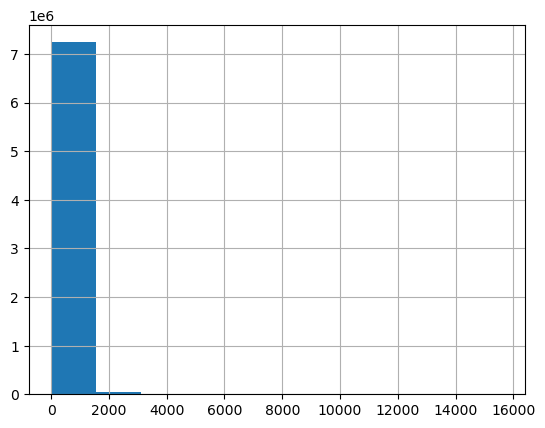

In [10]:
raw_grid.band.hist()

In [11]:
# raw_grid["log_band"] = np.log1p(raw_grid.band)

In [12]:
# raw_grid.sample(n=20_000).explore()

ghsl_df = raw_grid[["band","x","y"]].copy()

In [13]:
ghsl_df

,band,x,y
0,0.1,30.874156,2.125351
1,0.1,30.874156,2.042018
2,0.1,29.457496,-0.041307
3,0.1,29.124164,-0.291306
4,0.1,29.207497,-0.291306
...,...,...,...
7310068,0.2,16.707547,-17.374571
7310069,0.4,16.790880,-17.374571
7310070,0.5,16.874212,-17.374571
7310071,0.3,16.957546,-17.374571


## H3 + duckdb scale up

In [14]:
conn = ib.connect("duckdb://")

In [15]:
res = conn.raw_sql("""INSTALL h3 FROM community;
                   LOAD h3;""").df()

res

,Success


In [16]:
# loading the spatial extension.
res = conn.raw_sql("install spatial; load spatial").df()
res

,Success


In [17]:
ghsl_df.head()

,band,x,y
0,0.1,30.874156,2.125351
1,0.1,30.874156,2.042018
2,0.1,29.457496,-0.041307
3,0.1,29.124164,-0.291306
4,0.1,29.207497,-0.291306


### H3 and grid parameters

In [18]:
dose_wdi_geo_file = "/Users/cenv1069/Documents/data/datasets/local_data/dose-wdi/dose_wdi_geo.parquet"

dwg = conn.read_parquet(dose_wdi_geo_file,table_name="dwg")

In [19]:
dwg.head()

┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ gid_0  ┃ country ┃ gid_1   ┃ grp_usd_2015 ┃ services_usd_2015 ┃ manufacturing_usd_2015 ┃ agriculture_usd_2015 ┃ centr                                                           ┃ geometry                                                                                                                                                                                                                                    ┃ color             ┃ radius    ┃ x         ┃ y         ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ string │ string  │ string  │ float64      │ float64           │ float64                │ float64              │ binary                                                          │ binary                                                                                                                                                                                                                                      │ array<int64>      │ float64   │ float64   │ float64   │
├────────┼─────────┼─────────┼──────────────┼───────────────────┼────────────────────────┼──────────────────────┼─────────────────────────────────────────────────────────────────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────┼───────────────────┼───────────┼───────────┼───────────┤
│ ALB    │ Albania │ ALB.1_1 │ 4.341915e+08 │      2.009631e+08 │           9.449606e+07 │         8.588401e+07 │ b'\x01\x01\x00\x00\x00@\xa0\x88\x02=\x174@\x9d\xa3\xc5\xb3rPD@' │ b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\xbe\x02\x00\x00\x07h\x11@ a4@\xd3\xa9\x02 \xb47D@\xcd\x15\x10 d`4@\xc4G\xfe?\xd27D@\xa0*\xf0_j_4@\xd8\x98\xf8\x1f\xf07D@$\xb3\xfe\xbf\x7f^4@.:\xf6?\x028D@\x88\xce\xf8'+11165                        │ [238, 97, ... +2] │ 19.888996 │ 20.090775 │ 40.628500 │
│ ALB    │ Albania │ ALB.2_1 │ 3.719427e+08 │      1.721516e+08 │           8.094841e+07 │         7.357106e+07 │ b'\x01\x01\x00\x00\x00\xe6M\xcan\xe1?4@\x87\xf1\xed\xcdg\xcbD@' │ b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\xbb\x02\x00\x00\xa0\x16\x07\xc0\rl4@\xf5\x0e\xf9_\x15\xa4D@\xdfC\x15@)l4@u\xe3\xfe\x9f\x1a\xa4D@\x1f\x99\xf5\xff\xfdk4@:\xa9\xf5\x9f1\xa4D@\xb5O\t\x80\xd8k4@\xab\xc4\x02\x80_\xa4D@\x9fY\x12'+11117 │ [238, 97, ... +2] │ 19.734250 │ 20.249534 │ 41.589105 │
│ ALB    │ Albania │ ALB.3_1 │ 1.113524e+09 │      5.153885e+08 │           2.423439e+08 │         2.202575e+08 │ b'\x01\x01\x00\x00\x00\xb5?\xc3\x1e`\xa13@\x14\x15\xcd2B\xb9D@' │ b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\x8f\x0c\x00\x00\xb3@\xfd_\\\xa33@9\xad\x04 \xa8\xabD@\x85\x1a\xf0\xbf\xb6\xa23@\x13U\t`\x14\xabD@~r\x14 \n\xa33@+\xf0\xfc?\xda\xaaD@\xa8O\xf6\xbf\xf1\xa33@\xd1\x9a\xf6\xff7\xaaD@\xc0@\x10'+51373   │ [238, 97, ... +2] │ 20.830796 │ 19.630373 │ 41.447333 │
│ ALB    │ Albania │ ALB.4_1 │ 7.954835e+08 │      3.681851e+08 │           1.731265e+08 │         1.573483e+08 │ b'\x01\x01\x00\x00\x00\x17\xb66{\xbb/4@m\xda[\xa0\x1f\x85D@'    │ b'\x01\x03\x00\x00\x00\x01\x

In [20]:
conn.drop_view("ghsl_h3_",force=True)
# conn.drop_view("ghsl_h3",force=True)

In [21]:
print("Assuming raster grid resolution : ",grid_param)

h3_res = dt.rast_to_h3[str(grid_param)]["h3_res"]

print("Using base H3 resolution : ", h3_res)

res = conn.raw_sql(f"""create or replace view ghsl_h3_ as
               (select    
                    band,
                    h3_h3_to_string(h3_latlng_to_cell(y,x,{h3_res})) as h3_id,
                    x,
                    y
                   from ghsl_df);""")

res.df()

Assuming raster grid resolution :  10000
Using base H3 resolution :  8


,Count


In [22]:
ghsl_h3_ = conn.table("ghsl_h3_")

In [23]:
print(ghsl_h3_.count())
ghsl_h3_.head()

┌─────────┐
│ 7310073 │
└─────────┘


┏━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ band    ┃ h3_id           ┃ x         ┃ y         ┃
┡━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ float32 │ string          │ float64   │ float64   │
├─────────┼─────────────────┼───────────┼───────────┤
│     0.1 │ 886aee6b6bfffff │ 30.874156 │  2.125351 │
│     0.1 │ 886aee692dfffff │ 30.874156 │  2.042018 │
│     0.1 │ 886ac2a89bfffff │ 29.457496 │ -0.041307 │
│     0.1 │ 886ac20f23fffff │ 29.124164 │ -0.291306 │
│     0.1 │ 886ac20c1dfffff │ 29.207497 │ -0.291306 │
└─────────┴─────────────────┴───────────┴───────────┘

In [24]:
ghsl_h3_.h3_id.nunique()

┌────────┐
│ 144326 │
└────────┘

In [25]:
ghsl_h3 = conn.create_view("ghsl_h3",obj=ghsl_h3_.group_by("h3_id").agg(band=_.band.sum(),x=_.x.first(),y=_.y.first()),overwrite=True)
# ghsl_h3_.group_by("h3_id").agg(band=_.band.sum(),x=_.x.first(),y=_.y.first()).alias("ghsl_h3")

In [26]:
# ghsl_h3.sql(
# """
# select *, 
#     array_extract(h3_cell_to_latlng(h3_id),2) as x_h3, 
#     array_extract(h3_cell_to_latlng(h3_id),1) as y_h3
#     from ghsl_h3
# """)

In [27]:
conn.sql("select count(*) as N from ghsl_h3;")


┏━━━━━━━━┓
┃ N      ┃
┡━━━━━━━━┩
│ int64  │
├────────┤
│ 144326 │
└────────┘

In [28]:
# conn.drop_view("ghsl_h3_")

In [29]:
conn.list_tables()

['dwg', 'ghsl_h3', 'ghsl_h3_']

In [30]:
ghsl_h3.count()

┌────────┐
│ 144326 │
└────────┘

### Coordinates to plot only points

In [31]:

# h3_layer_ghsl_h3 = pdk.Layer(
#     "H3HexagonLayer",
#     ghsl_h3.execute(limit=100_000),
#     pickable=True,
#     stroked=True,
#     filled=True,
#     opacity=1,
#     extruded=False,
#     get_hexagon= "h3_id",
#     get_fill_color = [200,200,100,255],
#     get_line_color=[0, 0, 0, 100],
#     line_width_min_pixels=0,
#     line_width_max_pixels=1,
# )


points_layer = pdk.Layer(
    "ScatterplotLayer",
    ghsl_h3.execute(limit=100_000),
    pickable=False,
    opacity=0.8,
    stroked=False,
    filled=True,
    radius_scale=1,
    radius_min_pixels=1,
    radius_max_pixels=20,
    line_width_min_pixels=1,
    get_position = ["x","y"],
    get_radius=50,
    get_fill_color=[255, 140, 0, 255],
    get_line_color=[0, 0, 0, 0],
)


In [276]:
view_state_global = pdk.data_utils.compute_view(ghsl_df[["x","y"]])

# Create mapdeck object
deck_map_ghsl_h3 = pdk.Deck(layers=[
    # h3_layer_ghsl_h3,
    points_layer
    ]
             ,initial_view_state=view_state_global
             ,tooltip= {"text": "Value :  {band}"}
             ,map_style="road"
             )

deck_map_ghsl_h3.to_html("deck_maps/deck_ghsl_h3_grid.html",iframe_height=800,open_browser=False)

### Selecting an area

In [33]:

dwg.filter(_.country.re_search("Nigeria")).select("gid_0","country")#.sql("Select ST_GeomFromWKB(geometry) as geom from dwg;")

┏━━━━━━━━┳━━━━━━━━━┓
┃ gid_0  ┃ country ┃
┡━━━━━━━━╇━━━━━━━━━┩
│ string │ string  │
├────────┼─────────┤
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ NGA    │ Nigeria │
│ …      │ …       │
└────────┴─────────┘

In [34]:
selected_country = "NGA"

## Rescaling approach to econ data 

In [35]:
# conn.drop_view("country",force=True)


In [131]:

country = conn.sql(f"""
SELECT sel_country.* EXCLUDE (color,centr,geom,radius,x,y,grp_usd_2015,services_usd_2015,manufacturing_usd_2015),
         ghsl.*
         FROM ghsl_h3 AS ghsl
         JOIN (SELECT * EXCLUDE geometry, ST_GeomFromWKB(geometry) as geom FROM dwg where gid_0='{selected_country}') AS sel_country
         ON ST_Intersects(ST_Point(ghsl.x,ghsl.y),sel_country.geom);
         
""")

In [132]:
print(country.count())
country.head(3)

┌──────┐
│ 5338 │
└──────┘


┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ gid_0  ┃ country ┃ gid_1    ┃ agriculture_usd_2015 ┃ h3_id           ┃ band         ┃ x         ┃ y         ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ string │ string  │ string   │ float64              │ string          │ float64      │ float64   │ float64   │
├────────┼─────────┼──────────┼──────────────────────┼─────────────────┼──────────────┼───────────┼───────────┤
│ NGA    │ Nigeria │ NGA.18_1 │         2.143236e+09 │ 8858094e19fffff │  9634.199966 │ 10.124240 │ 12.958641 │
│ NGA    │ Nigeria │ NGA.18_1 │         2.143236e+09 │ 88580e65a9fffff │ 13891.199935 │  8.374246 │ 12.791975 │
│ NGA    │ Nigeria │ NGA.18_1 │         2.143236e+09 │ 88580ab2c5fffff │ 17798.399998 │  8.957578 │ 12.791975 │
└────────┴─────────┴──────────┴──────────────────────┴─────────────────┴──────────────┴───────────┴───────────┘

In [133]:
gid_1_band = country.group_by("gid_1").agg(total_band=_.band.sum())
gid_1_band

┏━━━━━━━━━━┳━━━━━━━━━━━━━━┓
┃ gid_1    ┃ total_band   ┃
┡━━━━━━━━━━╇━━━━━━━━━━━━━━┩
│ string   │ float64      │
├──────────┼──────────────┤
│ NGA.23_1 │ 5.009733e+06 │
│ NGA.28_1 │ 4.462595e+06 │
│ NGA.12_1 │ 5.137993e+06 │
│ NGA.11_1 │ 2.312121e+06 │
│ NGA.20_1 │ 5.539707e+06 │
│ NGA.15_1 │ 1.575078e+06 │
│ NGA.30_1 │ 2.118220e+06 │
│ NGA.37_1 │ 4.305252e+06 │
│ NGA.31_1 │ 4.715720e+06 │
│ NGA.16_1 │ 4.293570e+06 │
│ …        │            … │
└──────────┴──────────────┘

In [139]:
country_gdf = (country
           .join(gid_1_band,country.gid_1==gid_1_band.gid_1,how="left")
           .mutate(band_frac=_.band/_.total_band)
            # .mutate(h3_id_gdp=_.band_frac*_.build_gdp)
           ).to_pandas()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [140]:
print(country_gdf.shape)
country_gdf.head()

(5338, 11)


,gid_0,country,gid_1,agriculture_usd_2015,h3_id,band,x,y,gid_1_right,total_band,band_frac
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639
1,NGA,Nigeria,NGA.18_1,2.143236e+09,88580bb293fffff,10227.000044,10.124240,12.791975,NGA.18_1,3.991391e+06,0.002562
2,NGA,Nigeria,NGA.18_1,2.143236e+09,88580a9895fffff,12779.100140,8.540913,12.708642,NGA.18_1,3.991391e+06,0.003202
3,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ba4d3fffff,11984.700018,10.374239,12.625310,NGA.18_1,3.991391e+06,0.003003
4,NGA,Nigeria,NGA.20_1,2.325922e+09,88580a89e5fffff,26133.000078,8.540913,12.541976,NGA.20_1,5.539707e+06,0.004717


In [141]:
# gpd.GeoSeries(country_gdf[["x","y"]].apply(shp.Point,axis=1),crs="EPSG:4326").explore()

### Check that things add up

In [142]:
country_gdf[["gid_1","band_frac"]].groupby("gid_1").agg("sum")


,band_frac
gid_1,
NGA.10_1,1.0
NGA.11_1,1.0
NGA.12_1,1.0
NGA.13_1,1.0
NGA.15_1,1.0
NGA.16_1,1.0
NGA.18_1,1.0
NGA.19_1,1.0
NGA.20_1,1.0


### Mapping

In [146]:
import plotting as snplt

In [147]:
col_pal = "viridis"

col_pal = pypal.load_cmap(col_pal)

In [148]:
cols =  snplt.cmap((country_gdf.band),palette=col_pal) #pd.Series([[255*j for j in x] for x in bmlunge(compact_geo_downscaled["log_value"])])
country_gdf["color"] = cols
country_gdf.head(3)
# print(cols)
# print(unique_vals)

Max input : 55791.000288300216, palette colors : 10


,gid_0,country,gid_1,agriculture_usd_2015,h3_id,band,x,y,gid_1_right,total_band,band_frac,color
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]"
1,NGA,Nigeria,NGA.18_1,2.143236e+09,88580bb293fffff,10227.000044,10.124240,12.791975,NGA.18_1,3.991391e+06,0.002562,"[67, 62, 133, 255]"
2,NGA,Nigeria,NGA.18_1,2.143236e+09,88580a9895fffff,12779.100140,8.540913,12.708642,NGA.18_1,3.991391e+06,0.003202,"[56, 88, 140, 255]"


In [149]:
view_state = pdk.data_utils.compute_view(points=country_gdf[["x","y"]])


In [150]:
# # this map is not really usefull at high resolutions

# h3_layer_down = pdk.Layer(
#     "H3HexagonLayer",
#     country_gdf[["gid_0","gid_1","h3_id","total_band","h3_id_gdp","color"]],
#     pickable=True,
#     stroked=True,
#     filled=True,
#     opacity=.8,
#     extruded=False,
#     get_hexagon= "h3_id",
#     get_fill_color = "color",
#     get_line_color= [0, 0, 0, 100],
#     line_width_min_pixels=0,
#     line_width_max_pixels=1,
# )


# layer_down = pdk.Layer(
#     "ScatterplotLayer",
#     country_gdf[["h3_id_gdp","x","y"]],
#     pickable=False,
#     opacity=0.4,
#     stroked=False,
#     filled=True,
#     radius_scale=6,
#     radius_min_pixels=1,
#     radius_max_pixels=10,
#     line_width_min_pixels=1,
#     get_position = ["x","y"],
#     get_radius=50,
#     get_fill_color=[255, 140, 0, 255],
#     get_line_color=[0, 0, 0, 0],
# )


In [151]:

# # Create mapdeck object
# deck_map_down = pdk.Deck(layers=[
#     h3_layer_down,
#     layer_down
#     ]
#              ,initial_view_state=view_state
#             #  ,tooltip= {"text": "Value :  {h3_id_gdp}"}
#              ,height=800
#              ,map_style="road"
#              )

# deck_map_down.to_html("deck_maps/deck_ghsl_h3_down_grid.html")

### Gridding

In [152]:
rast_to_h3 = dt.rast_to_h3_map(x=country_gdf["x"].mean(),y = country_gdf["y"].mean())

# h3_res = dt.rast_to_h3["100"]["h3_res"]

# square = dt.square_poly(lat=country_gdf.loc[0,"y"],lon=country_gdf.loc[0,"x"],distance=100)

# ref_cell = h3.latlng_to_cell(lat=country_gdf.loc[0,"y"],lng=country_gdf.loc[0,"x"],res=h3_res )
# ref_cell_ij = h3.cell_to_local_ij(origin=ref_cell,h=ref_cell)

# cells = h3.geo_to_cells(square,res=h3_res )

# cells_ij = [h3.cell_to_local_ij(origin=ref_cell,h=cell) for cell in cells]

# neighbs = rast_to_h3["100"]["nn"]
# # [(cell_i-ref_cell_ij[0],cell_j-ref_cell_ij[1]) for (cell_i,cell_j) in cells_ij]

# ####
# neighb_cells = [h3.local_ij_to_cell(origin=ref_cell,i=neighb[0]+ref_cell_ij[0],j=neighb[1]+ref_cell_ij[1]) for neighb in neighbs]

# reconstructed = dt.centre_cell_to_square(ref_cell,grid_param=grid_param,neighbs=neighbs)


In [153]:

# gpd.GeoSeries([
#     square,
#                h3.cells_to_h3shape(neighb_cells)
#                ,h3.cells_to_h3shape(reconstructed)
#                ],crs="EPSG:4326").explore()

In [154]:
# ideally, this is precomputed, but for some reason it has not worked...
neighbs = rast_to_h3[str(grid_param)]["nn"]

country_gdf["h3_gridded"] = pd.Series(country_gdf.apply(lambda row: dt.centre_cell_to_square(h3_cell = row["h3_id"],neighbs=neighbs,grid_param=grid_param),axis=1).tolist())

In [155]:
country_gdf.dropna(subset=["h3_gridded"],inplace=True)

### Gridded data set 

In [156]:
ghsl_gridded = country_gdf.explode("h3_gridded")

In [157]:
print(ghsl_gridded.shape)
ghsl_gridded.head(3)

(790024, 13)


,gid_0,country,gid_1,agriculture_usd_2015,h3_id,band,x,y,gid_1_right,total_band,band_frac,color,h3_gridded
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab443fffff
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab46bfffff
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab633fffff


In [158]:
ghsl_gridded = ghsl_gridded[~ghsl_gridded.duplicated(subset=["h3_gridded"])]

In [159]:
print(ghsl_gridded.shape)
ghsl_gridded.reset_index(inplace=True,drop=True)

(681102, 13)


In [160]:
ghsl_gridded.head(3)

,gid_0,country,gid_1,agriculture_usd_2015,h3_id,band,x,y,gid_1_right,total_band,band_frac,color,h3_gridded
0,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab443fffff
1,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab46bfffff
2,NGA,Nigeria,NGA.18_1,2.143236e+09,88580ab6c7fffff,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab633fffff


In [161]:
ghsl_gridded.set_index("h3_id",inplace=True,drop=True)

In [162]:
ghsl_gridded = ghsl_gridded.join(ghsl_gridded.value_counts("h3_id"),how="left",sort=False,validate="m:1")

In [164]:
# ghsl_gridded["h3_id_gdp_gridded"] = np.round(ghsl_gridded["h3_id_gdp"]/ghsl_gridded["count"])
ghsl_gridded["h3_id_band_gridded"] = np.round(ghsl_gridded["band"]/ghsl_gridded["count"])

In [165]:
ghsl_gridded.reset_index(inplace=True,drop=False)

In [166]:
# ghsl_gridded.dropna(axis=0,subset=["h3_gridded"],inplace=True)

In [167]:
print(ghsl_gridded.shape)
ghsl_gridded.head(3)

(681102, 15)


,h3_id,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_gridded,count,h3_id_band_gridded
0,88580ab6c7fffff,NGA,Nigeria,NGA.18_1,2.143236e+09,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab443fffff,148,71.0
1,88580ab6c7fffff,NGA,Nigeria,NGA.18_1,2.143236e+09,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab46bfffff,148,71.0
2,88580ab6c7fffff,NGA,Nigeria,NGA.18_1,2.143236e+09,10532.700021,9.124244,12.791975,NGA.18_1,3.991391e+06,0.002639,"[67, 62, 133, 255]",88580ab633fffff,148,71.0


In [168]:
# quick check that the region filtering worked : 
# just lots of duplicates
# gpd.GeoSeries(ghsl_gridded[["x","y"]].sample(10_000).apply(shp.Point,axis=1),crs="epsg:4326").explore()

In [193]:
# view_state = pdk.data_utils.compute_view(points=ghsl_gridded.sample(10000)["h3_gridded"].apply(lambda cell: h3.cell_to_latlng(cell)[::-1]))

# lagos: latitude = 6.450151,longitude = 3.531193 !!!! DOES NOT WORK BECAUSE IT IS EXCLUDED FROM DOSE!!!
# Abidjan :  latitude = 5.367, longitude = -4.009
# Kano : latitude = 11.985, longitude = 8.533

zoom_lat=11.985
zoom_lon=8.533
zoom_width=70_000

view_state_zoomed = pdk.ViewState(latitude = zoom_lat,longitude = zoom_lon,zoom=11,pitch=30,bearing=0) 

In [194]:
# extracting data for the plotting region : 

plotting_region = dt.square_poly(lat=zoom_lat,lon=zoom_lon,distance=zoom_width)
# gpd.GeoSeries(plotting_region,crs="EPSG:4326").explore()

In [195]:

limits = [np.round(x,3) for x in plotting_region.bounds]
limits


[8.212, 11.671, 8.854, 12.299]

In [196]:
# ghsl_gridded

ghsl_gridded_zoom = conn.sql(
f"""
Select * from 
    (select *, 
    array_extract(h3_cell_to_latlng(h3_gridded),2) as x_h3, 
    array_extract(h3_cell_to_latlng(h3_gridded),1) as y_h3
    from ghsl_gridded)
where (x <= {limits[2]}) and (x >= {limits[0]}) and (y <= {limits[3]}) and (y >= {limits[1]});
""").execute()

print(ghsl_gridded_zoom.shape)
ghsl_gridded_zoom.head(3)

(6460, 17)


,h3_id,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_gridded,count,h3_id_band_gridded,x_h3,y_h3
0,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[37, 133, 142, 255]",88580a55c9fffff,148,157.0,9.089148,12.759860
1,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[37, 133, 142, 255]",88580a5513fffff,148,157.0,9.077121,12.748855
2,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[37, 133, 142, 255]",88580a5439fffff,148,157.0,9.098895,12.778925


In [197]:
# gpd.GeoSeries(ghsl_gridded_zoom[["x","y"]].apply(shp.Point,axis=1),crs="epsg:4326").explore()

In [198]:
ghsl_gridded_zoom["color"] = cmap(ghsl_gridded_zoom["h3_id_band_gridded"],palette=col_pal)

Max input : 279.0, palette colors : 10


In [260]:
h3_layer_ghsl_h3_gridded = pdk.Layer(
    "H3HexagonLayer",
    # ghsl_gridded.loc[0:200_000],
    ghsl_gridded_zoom,
    pickable=True,
    stroked=True,
    filled=True,
    opacity=.5,
    extruded=False,
    get_hexagon= "h3_gridded",
    get_fill_color = "color",
    get_line_color= [0, 0, 0, 100],
    line_width_min_pixels=1,
    line_width_max_pixels=1,
)


layer_down = pdk.Layer(
    "ScatterplotLayer",
    country_gdf[["x","y"]],
    pickable=False,
    opacity=0.8,
    stroked=False,
    filled=True,
    radius_scale=10,
    radius_min_pixels=1,
    radius_max_pixels=20,
    line_width_min_pixels=0,
    line_width_max_pixels=0,
    get_position = ["x","y"],
    get_radius=25,
    get_fill_color=[255, 140, 0, 255],
    get_line_color=[0, 0, 0, 0],
)



In [275]:
# Create mapdeck object

deck_map_ghsl_h3_gridded = pdk.Deck(layers=[h3_layer_ghsl_h3_gridded, 
                                            layer_down
                                            ]
             ,initial_view_state=view_state_zoomed
             ,tooltip= {"text": "Value :  {h3_id_band_gridded}"}
             ,height=800
             ,map_style="road"
             )

deck_map_ghsl_h3_gridded.to_html("deck_maps/deck_ghsl_nres_h3_gridded.html",open_browser=True,iframe_height=800)

## Changing Scales

In [201]:
ghsl_rescaled = ghsl_gridded_zoom.rename(columns={"h3_id_gdp_gridded" : "h3_id_gdp_gridded_var",
                                    "h3_id_band_gridded" : "h3_id_band_gridded_var",
                                    "h3_id" : "h3_gridded_parent"
                                    },inplace=False)

In [202]:

ghsl_rescaled.rename(columns={"h3_gridded" : "h3_id"
                             },inplace=True)


In [203]:
ghsl_rescaled.head(3)

,h3_gridded_parent,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_id,count,h3_id_band_gridded_var,x_h3,y_h3
0,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a55c9fffff,148,157.0,9.089148,12.759860
1,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a5513fffff,148,157.0,9.077121,12.748855
2,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a5439fffff,148,157.0,9.098895,12.778925


In [204]:
h3_gridded_new_scale = sd.change_scale(ghsl_rescaled,level=-1)

# h3_gridded_new_scale = sd.change_scale(h3_gridded_new_scale,level=1)

In [205]:
print(h3_gridded_new_scale.shape)
h3_gridded_new_scale.head()

(974, 3)


,h3_id,child_cells,h3_id_band_gridded_var
0,87580a001ffffff,"[88580a0013fffff, 88580a0017fffff, 88580a0015f...",237.0
1,87580a002ffffff,"[88580a0023fffff, 88580a002dfffff, 88580a0027f...",1362.0
2,87580a003ffffff,"[88580a0039fffff, 88580a0033fffff, 88580a0037f...",849.0
3,87580a008ffffff,"[88580a0081fffff, 88580a0085fffff, 88580a0089f...",553.0
4,87580a009ffffff,"[88580a0093fffff, 88580a0097fffff, 88580a009bf...",553.0


In [206]:
h3_gridded_new_scale["color"] = cmap((h3_gridded_new_scale.h3_id_band_gridded_var),palette=col_pal)

Max input : 1953.0, palette colors : 10


In [256]:
#####

h3_layer_ghsl_h3_gridded_new_scale = pdk.Layer(
    "H3HexagonLayer",
    h3_gridded_new_scale,
    pickable=True,
    stroked=True,
    filled=True,
    opacity=.5,
    extruded=False,
    get_hexagon= "h3_id",
    get_fill_color = "color",
    get_line_color= [0, 0, 0, 100],
    line_width_min_pixels=1,
    line_width_max_pixels=1,
)


In [274]:
# Create mapdeck object
deck_map_ghsl_h3_gridded_rescaled = pdk.Deck(layers=[h3_layer_ghsl_h3_gridded_new_scale]
             ,initial_view_state=view_state_zoomed
             ,tooltip= {"text": "Value :  {h3_id_gdp_gridded_var}"}
             ,map_style="road"
             )

deck_map_ghsl_h3_gridded_rescaled.to_html("deck_maps/deck_ghsl_nres_h3_gridded_new_scale.html",iframe_height=800,open_browser=True)

## Adding constraint layer

This time, GHSL data gives a hint at where there is no agricultural lands. Start weith loading in the *ghsl* layer just like a base layer 

In [209]:
grid_ghsl_param = 100

ghsl_file = f"/Users/cenv1069/Documents/data/datasets/JRC/S_{grid_ghsl_param}m_total/**"
# "/Users/cenv1069/Documents/agriculture/ghsl/non_res/**"
# "/Users/cenv1069/Documents/data/datasets/JRC/S_10m/**"

tiffs = [x for x in glob.glob(ghsl_file,recursive=True) if re.search(pattern=".tif$",string=x)]
print(len(tiffs))
tiffs

1


['/Users/cenv1069/Documents/data/datasets/JRC/S_100m_total/GHS_BUILT_S_E2020_GLOBE_R2023A_54009_100_V1_0_R8_C19/GHS_BUILT_S_E2020_GLOBE_R2023A_54009_100_V1_0_R8_C19.tif']

In [210]:
out_folder = "outputs"

out_filename = f'S_{grid_ghsl_param}m_total_raw_grid.parquet'

out_file = f"{out_folder}/{out_filename}"

In [211]:

if os.path.exists(out_file):
    print("Reading existing file")
    raw_grid_constraint = conn.read_parquet(out_file,table_name="raw_grid_constraint_")
else :
    print("Converting rasters to centroids.")
    raw_grid_constraint = dt.rast_to_centroid(out_file,tiff_paths=tiffs)
    raw_grid_constraint.to_parquet(out_file)

Reading existing file


In [212]:
# print(raw_grid_constraint.count())
# raw_grid_constraint.head()


In [213]:
# conn.drop_view("raw_grid_constraint")

In [214]:
# raw_grid_constraint[["x","y"]] = (gpd.GeoDataFrame(raw_grid_constraint,geometry=gpd.GeoSeries(raw_grid_constraint.apply(lambda row: shp.Point(row.loc["lon"],row.loc["lat"]),axis=1),crs="ESRI:54009"))
#                                   .to_crs(epsg=4326)
#                                   .get_coordinates())
conn.raw_sql(
"""
create or replace view raw_grid_constraint as
    (select 
        band, 
        ST_X(geom) as x,
        ST_Y(geom) as y 
    from
        (select 
            band, 
            ST_Transform(ST_Point(lon,lat), 'ESRI:54009', 'EPSG:4326',true) as geom 
        from raw_grid_constraint_));""")

In [215]:
# raw_grid_constraint.drop(columns=["lon","lat"],inplace=True)
raw_grid_constraint = conn.table("raw_grid_constraint")
raw_grid_constraint.head()

┏━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ band   ┃ x         ┃ y         ┃
┡━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ uint16 │ float64   │ float64   │
├────────┼───────────┼───────────┤
│     29 │ -0.103859 │ 16.258758 │
│     92 │ -0.102836 │ 16.258758 │
│   1094 │ -0.056790 │ 16.258758 │
│   3917 │ -0.055767 │ 16.258758 │
│   2795 │ -0.054744 │ 16.258758 │
└────────┴───────────┴───────────┘

In [216]:
# raw_grid_constraint.crs
# import pyarrow.parquet
# pyarrow.parquet.read_metadata(out_file)

In [217]:
# raw_grid_constraint.band.hist()

In [218]:
print("Assuming constraint raster grid resolution : ",grid_ghsl_param)

h3_res_constraint = dt.rast_to_h3[str(grid_ghsl_param)]["h3_res"]

print("Using base H3 resolution : ", h3_res_constraint)

res = conn.raw_sql(f"""create or replace view ghsl_constraint as
               (select    
                    band,
                    h3_h3_to_string(h3_latlng_to_cell(y,x,{h3_res_constraint})) as h3_id,
                    x,
                    y
                   from raw_grid_constraint);""")

res.df()

Assuming constraint raster grid resolution :  100
Using base H3 resolution :  12


,Count


In [219]:
ghsl_constraint = conn.table("ghsl_constraint")

In [220]:
print(ghsl_constraint.count())
ghsl_constraint.head()

┌─────────┐
│ 8084661 │
└─────────┘


┏━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ band   ┃ h3_id           ┃ x         ┃ y         ┃
┡━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ uint16 │ string          │ float64   │ float64   │
├────────┼─────────────────┼───────────┼───────────┤
│     29 │ 8c59ac4085583ff │ -0.103859 │ 16.258758 │
│     92 │ 8c59ac4084655ff │ -0.102836 │ 16.258758 │
│   1094 │ 8c59ac4546369ff │ -0.056790 │ 16.258758 │
│   3917 │ 8c59ac454631bff │ -0.055767 │ 16.258758 │
│   2795 │ 8c59ac45462adff │ -0.054744 │ 16.258758 │
└────────┴─────────────────┴───────────┴───────────┘

In [221]:
ghsl_constraint.h3_id.nunique()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

┌─────────┐
│ 8084661 │
└─────────┘

In [222]:
# ghsl_h3 = conn.create_view("ghsl_h3",obj=ghsl_h3.group_by("h3_id").agg(band=_.band.sum(),x=_.x.first(),y=_.y.first()))
# ghsl_constaint = ghsl_constaint.group_by("h3_id").agg(band=_.band.sum(),x=_.x.first(),y=_.y.first()).execute()

In [223]:
conn.sql("select count(*) as N from ghsl_constraint;")


┏━━━━━━━━━┓
┃ N       ┃
┡━━━━━━━━━┩
│ int64   │
├─────────┤
│ 8084661 │
└─────────┘

In [224]:
ghsl_constraint

┏━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ band   ┃ h3_id           ┃ x         ┃ y         ┃
┡━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━┩
│ uint16 │ string          │ float64   │ float64   │
├────────┼─────────────────┼───────────┼───────────┤
│     29 │ 8c59ac4085583ff │ -0.103859 │ 16.258758 │
│     92 │ 8c59ac4084655ff │ -0.102836 │ 16.258758 │
│   1094 │ 8c59ac4546369ff │ -0.056790 │ 16.258758 │
│   3917 │ 8c59ac454631bff │ -0.055767 │ 16.258758 │
│   2795 │ 8c59ac45462adff │ -0.054744 │ 16.258758 │
│   2226 │ 8c59ac4546761ff │ -0.053720 │ 16.258758 │
│   3302 │ 8c59ac4546713ff │ -0.052697 │ 16.258758 │
│   3764 │ 8c59ac45466a5ff │ -0.051674 │ 16.258758 │
│   3221 │ 8c59ac4509367ff │ -0.050651 │ 16.258758 │
│   3644 │ 8c59ac450906dff │ -0.049627 │ 16.258758 │
│      … │ …               │         … │         … │
└────────┴─────────────────┴───────────┴───────────┘

In [225]:
ghsl_constraint = conn.sql(
f"""
Select * from 
    (select *, 
    from ghsl_constraint)
where (x <= {limits[2]}) and (x >= {limits[0]}) and (y <= {limits[3]}) and (y >= {limits[1]}) and (band > 3000);
""").execute()

print(ghsl_constraint.shape)
ghsl_constraint.head(3)

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

(31382, 4)


,band,h3_id,x,y
0,3792,8c580acdc00a9ff,8.422843,12.298367
1,3734,8c580acdc0545ff,8.423855,12.298367
2,3122,8c580acdc051bff,8.424867,12.298367


### Gridding the constraint

In [226]:
rast_to_h3 = dt.rast_to_h3_map(x=ghsl_constraint["x"].mean(),y = ghsl_constraint["y"].mean())

# h3_res = dt.rast_to_h3["100"]["h3_res"]

# square = dt.square_poly(lat=country_gdf.loc[0,"y"],lon=country_gdf.loc[0,"x"],distance=100)

# ref_cell = h3.latlng_to_cell(lat=country_gdf.loc[0,"y"],lng=country_gdf.loc[0,"x"],res=h3_res )
# ref_cell_ij = h3.cell_to_local_ij(origin=ref_cell,h=ref_cell)

# cells = h3.geo_to_cells(square,res=h3_res )

# cells_ij = [h3.cell_to_local_ij(origin=ref_cell,h=cell) for cell in cells]

# neighbs = rast_to_h3["100"]["nn"]
# # [(cell_i-ref_cell_ij[0],cell_j-ref_cell_ij[1]) for (cell_i,cell_j) in cells_ij]

# ####
# neighb_cells = [h3.local_ij_to_cell(origin=ref_cell,i=neighb[0]+ref_cell_ij[0],j=neighb[1]+ref_cell_ij[1]) for neighb in neighbs]

# reconstructed = dt.centre_cell_to_square(ref_cell,grid_param=grid_param,neighbs=neighbs)


In [227]:

# gpd.GeoSeries([
#     square,
#                h3.cells_to_h3shape(neighb_cells)
#                ,h3.cells_to_h3shape(reconstructed)
#                ],crs="EPSG:4326").explore()

In [228]:
# ideally, this is precomputed, but for some reason it has not worked...
neighbs = rast_to_h3[str(grid_ghsl_param)]["nn"]

ghsl_constraint["h3_gridded"] = pd.Series(ghsl_constraint.apply(lambda row: dt.centre_cell_to_square(h3_cell = row["h3_id"],neighbs=neighbs,grid_param=grid_ghsl_param),axis=1).tolist())

In [229]:
ghsl_constraint.dropna(subset=["h3_gridded"],inplace=True)

### Gridded data set 

In [230]:
constraint_gridded = ghsl_constraint.explode("h3_gridded")

In [231]:
print(constraint_gridded.shape)
constraint_gridded.head(3)

(1035606, 5)


,band,h3_id,x,y,h3_gridded
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc00b5ff
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0087ff
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0081ff


In [232]:
constraint_gridded_zoom = constraint_gridded[~constraint_gridded.duplicated(subset=["h3_gridded"])].copy()

In [233]:
print(constraint_gridded_zoom.shape)
constraint_gridded_zoom.reset_index(inplace=True,drop=True)

(982332, 5)


In [234]:
constraint_gridded.head(3)

,band,h3_id,x,y,h3_gridded
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc00b5ff
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0087ff
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0081ff


In [235]:
# gpd.GeoSeries(constraint_gridded[["x","y"]].apply(shp.Point,axis=1),crs="espg:4326")

In [236]:
# constraint_gridded_zoom = conn.sql(
# f"""
# Select * from 
#     (select *, 
#     array_extract(h3_cell_to_latlng(h3_gridded),2) as x_h3, 
#     array_extract(h3_cell_to_latlng(h3_gridded),1) as y_h3
#     from constraint_gridded)
# where (x <= {limits[2]}) and (x >= {limits[0]}) and (y <= {limits[3]}) and (y >= {limits[1]});
# """).execute()

# print(constraint_gridded_zoom.shape)
# constraint_gridded_zoom.head(3)

In [237]:
# gpd.GeoSeries(constraint_gridded[["x","y"]].apply(shp.Point,axis=1),crs="epsg:4326").explore()

## Matching Resolution
bringing the variable layer and the constrain layer to a common resolution

In [238]:
constraint_res = h3.get_resolution(constraint_gridded_zoom.h3_gridded[0])
layer_res = h3.get_resolution(ghsl_gridded_zoom.h3_gridded[0])

print("Constrain res : ",constraint_res,", Layer res: ",layer_res)

Constrain res :  12 , Layer res:  8


Let's meet somewhere in between.

In [239]:
constraint_gridded_zoom.rename(columns={"h3_id" : "h3_native"
                                ,"h3_gridded" : "h3_id"},inplace=True)

ghsl_gridded_zoom.rename(columns={"h3_id" : "h3_native"
                                ,"h3_gridded" : "h3_id"},inplace=True)

In [240]:
constraint_gridded_zoom.head()

,band,h3_native,x,y,h3_id
0,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc00b5ff
1,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0087ff
2,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc0081ff
3,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc00bdff
4,3792,8c580acdc00a9ff,8.422843,12.298367,8c580acdc01dbff


In [241]:
ghsl_gridded_zoom.head()

,h3_native,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_id,count,h3_id_band_gridded,x_h3,y_h3
0,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a55c9fffff,148,157.0,9.089148,12.759860
1,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a5513fffff,148,157.0,9.077121,12.748855
2,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a5439fffff,148,157.0,9.098895,12.778925
3,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a56b7fffff,148,157.0,9.145593,12.801340
4,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",88580a54c1fffff,148,157.0,9.133551,12.790329


In [242]:
constraint_gridded_zoom_rescaled = sd.change_scale(constraint_gridded_zoom,level=-3)

In [243]:
ghsl_gridded_zoom_rescaled = sd.change_scale(ghsl_gridded_zoom,level=1)

In [244]:
constraint_res = h3.get_resolution(constraint_gridded_zoom_rescaled.h3_id[0])
layer_res = h3.get_resolution(ghsl_gridded_zoom_rescaled.h3_id[0])

print("Constrain res : ",constraint_res,", Layer res: ",layer_res)

Constrain res :  9 , Layer res:  9


In [262]:
print(ghsl_gridded_zoom_rescaled.shape)
ghsl_gridded_zoom_rescaled.head()

(45220, 17)


,h3_native,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_id,count,h3_id_band_gridded,x_h3,y_h3
0,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c83ffff,148,157.0,9.089148,12.75986
1,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c87ffff,148,157.0,9.089148,12.75986
2,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c8bffff,148,157.0,9.089148,12.75986
3,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c8fffff,148,157.0,9.089148,12.75986
4,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c93ffff,148,157.0,9.089148,12.75986


In [263]:
print(constraint_gridded_zoom_rescaled.shape)
constraint_gridded_zoom_rescaled.head()

(8399, 2)


,h3_id,child_cells
0,89580a0129bffff,"[8a580a012987fff, 8a580a012997fff, 8a580a01299..."
1,89580a012d3ffff,"[8a580a012d0ffff, 8a580a012d27fff, 8a580a012d2..."
2,89580a012d7ffff,"[8a580a012d47fff, 8a580a012d67fff, 8a580a012d7..."
3,89580a0164bffff,"[8a580a016497fff, 8a580a01649ffff]"
4,89580a01667ffff,[8a580a01665ffff]


In [247]:
layer_constrained = ghsl_gridded_zoom_rescaled.merge(constraint_gridded_zoom_rescaled,on="h3_id",how="left")

In [248]:
print(layer_constrained.shape)
layer_constrained.head(3)

(45220, 18)


,h3_native,gid_0,country,gid_1,agriculture_usd_2015,band,x,y,gid_1_right,total_band,band_frac,color,h3_id,count,h3_id_band_gridded,x_h3,y_h3,child_cells
0,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c83ffff,148,157.0,9.089148,12.75986,NaN
1,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c87ffff,148,157.0,9.089148,12.75986,"[8a580a55c84ffff, 8a580a55c857fff, 8a580a55c85..."
2,88580a54cdfffff,NGA,Nigeria,NGA.20_1,2.325922e+09,23168.399939,8.540913,12.208644,NGA.20_1,5.539707e+06,0.004182,"[30, 155, 138, 255]",89580a55c8bffff,148,157.0,9.089148,12.75986,NaN


In [249]:
# We exclude the cells for which the constraint was identified, their 'child_cell' variable is not na
layer_constrained = layer_constrained[layer_constrained.child_cells.isna()]
# layer_constrained.reset_index(drop=False,inplace=True)

In [250]:
layer_constrained.columns

Index(['h3_native', 'gid_0', 'country', 'gid_1', 'agriculture_usd_2015',
       'band', 'x', 'y', 'gid_1_right', 'total_band', 'band_frac', 'color',
       'h3_id', 'count', 'h3_id_band_gridded', 'x_h3', 'y_h3', 'child_cells'],
      dtype='object')

In [251]:
layer_constrained.shape

(37251, 18)

In [252]:
# layer_constrained.groupby("h3_id")

In [253]:
layer_constrained["color"] = cmap((layer_constrained.h3_id_band_gridded),palette=col_pal)

Max input : 279.0, palette colors : 10


In [272]:
#####

constrained_layer = pdk.Layer(
    "H3HexagonLayer",
    layer_constrained,
    pickable=True,
    stroked=True,
    filled=True,
    opacity=.5,
    extruded=False,
    get_hexagon= "h3_id",
    get_fill_color = "color",
    get_line_color= [0, 0, 0, 100],
    line_width_min_pixels=0,
    line_width_max_pixels=1,
)
constraint_layer = pdk.Layer(
    "H3HexagonLayer",
    constraint_gridded_zoom_rescaled,
    pickable=True,
    stroked=True,
    filled=True,
    opacity=.5,
    extruded=False,
    get_hexagon= "h3_id",
    get_fill_color = [56, 65, 87, 255],
    get_line_color= [0, 0, 0, 100],
    line_width_min_pixels=0,
    line_width_max_pixels=1,
)




In [273]:
# Create mapdeck object
deck_map_agri_layer_constrained = pdk.Deck(layers=[
    # constrained_layer,
    constraint_layer]
             ,initial_view_state=view_state_zoomed
             ,tooltip= {"text": "Value :  {h3_id_band_gridded_var}"}
             ,map_style="road"
             )

deck_map_agri_layer_constrained.to_html("deck_maps/deck_ghsl_agri_constrained.html",iframe_height=800,open_browser=True)